# Setup


In [ ]:
from google.colab import drive

drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
%pip install -q scikit-plot

In [1]:
from IPython.display import Image

In [ ]:
import os
import cv2
import shutil
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt

from tqdm import tqdm
from glob import glob
from random import randint

from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import (
    accuracy_score,
    roc_auc_score,
    classification_report,
    confusion_matrix,
)
from scikitplot.metrics import plot_confusion_matrix

import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import Recall, Precision
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import plot_model, Sequence, to_categorical
from tensorflow.keras.layers import (
    Input,
    Dense,
    Lambda,
    Reshape,
    Dropout,
    BatchNormalization,
    Resizing,
)
from tensorflow.keras.callbacks import (
    Callback,
    EarlyStopping,
    ModelCheckpoint,
    ReduceLROnPlateau,
    TensorBoard,
)
from tensorflow.keras.applications import (
    EfficientNetV2B0,
    EfficientNetV2B1,
    EfficientNetV2B2,
    EfficientNetV2B3,
    EfficientNetV2S,
)

print(tf.__version__)

2.15.0


In [ ]:
%load_ext tensorboard
# %reload_ext tensorboard

# Data Preparation


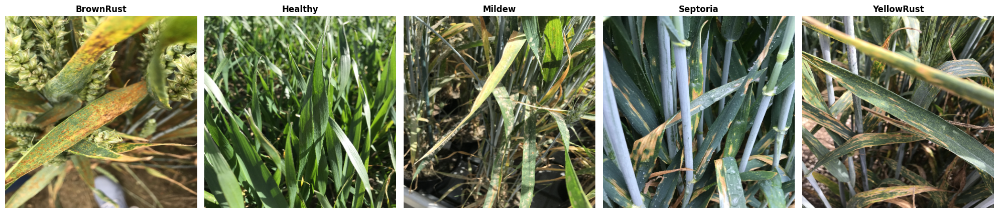

In [ ]:
# visualize images from each class
fig = plt.figure(figsize=(20, 20))
classes_ = ["BrownRust", "Healthy", "Mildew", "Septoria", "YellowRust"]

i = 0
for cls in classes_:
    i += 1
    paths = glob(f"/content/drive/MyDrive/WheatDiseaseDetection/Dataset/Train/{cls}/*")
    rand_idx = randint(0, len(paths))
    img = cv2.cvtColor(cv2.imread(paths[rand_idx]), cv2.COLOR_BGR2RGB)

    plt.subplot(1, len(classes_), i)
    plt.title(cls, fontweight="bold")
    plt.imshow(img)
    plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
root_path = "/content/drive/MyDrive/WheatDiseaseDetection/Dataset"
print(f'No. of Yellow Rust Images:  {len(glob(f"{root_path}/**/YellowRust/*"))}')
print(f' No. of Brown Rust Images:  {len(glob(f"{root_path}/**/BrownRust/*"))}')
print(f'   No. of Septoria Images:  {len(glob(f"{root_path}/**/Septoria/*"))}')
print(f'    No. of Healthy Images:  {len(glob(f"{root_path}/**/Healthy/*"))}')
print(f'     No. of Mildew Images:  {len(glob(f"{root_path}/**/Mildew/*"))}')
print(f'      No. of Total Images:  {len(glob(f"{root_path}/**/**/*"))}')

No. of Yellow Rust Images:  4398
 No. of Brown Rust Images:  2502
   No. of Septoria Images:  7043
    No. of Healthy Images:  2279
     No. of Mildew Images:  2941
      No. of Total Images:  19163


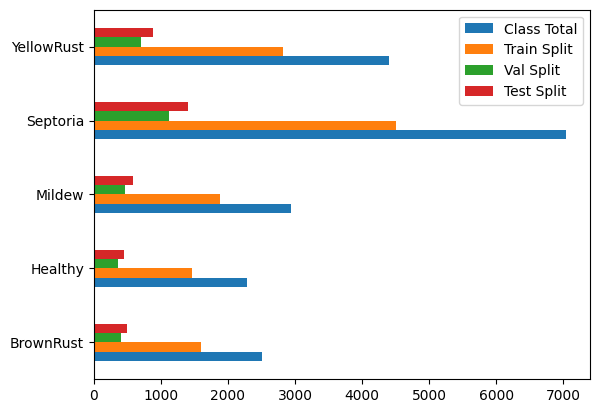

In [ ]:
root_path = "/content/drive/MyDrive/WheatDiseaseDetection/Dataset"
classes = ["BrownRust", "Healthy", "Mildew", "Septoria", "YellowRust"]

cls_total, train_split, val_split, test_split = [], [], [], []
for cls in classes:
    train_split.append(len(glob(f"{root_path}/Train/{cls}/*")))
    val_split.append(len(glob(f"{root_path}/Val/{cls}/*")))
    test_split.append(len(glob(f"{root_path}/Test/{cls}/*")))
    cls_total.append(len(glob(f"{root_path}/**/{cls}/*")))

pd.DataFrame(
    {
        "Class Total": cls_total,
        "Train Split": train_split,
        "Val Split": val_split,
        "Test Split": test_split,
    },
    index=classes,
).plot.barh()
plt.show()

In [ ]:
# image data generators
target_size_ = (400, 400)
batch_size_ = 24
classes_ = ["BrownRust", "Healthy", "Mildew", "Septoria", "YellowRust"]

Datagen = ImageDataGenerator(horizontal_flip=True, vertical_flip=True)
train_generator = Datagen.flow_from_directory(
    directory="/content/drive/MyDrive/WheatDiseaseDetection/Dataset/Train",
    target_size=target_size_,
    batch_size=batch_size_,
    classes=classes_,
    seed=42,
)

val_generator = Datagen.flow_from_directory(
    directory="/content/drive/MyDrive/WheatDiseaseDetection/Dataset/Val",
    target_size=target_size_,
    batch_size=batch_size_,
    classes=classes_,
    seed=42,
)

test_generator = ImageDataGenerator().flow_from_directory(
    directory="/content/drive/MyDrive/WheatDiseaseDetection/Dataset/Test",
    target_size=target_size_,
    batch_size=batch_size_,
    seed=42,
    classes=classes_,
    shuffle=False,
)

Found 12260 images belonging to 5 classes.
Found 3068 images belonging to 5 classes.
Found 3835 images belonging to 5 classes.


In [ ]:
print(f"No. of steps for training:   {train_generator.__len__()}")
print(f"No. of steps for validation: {val_generator.__len__()}")
print(f"No. of steps for testing:    {test_generator.__len__()}")

## Trails


In [ ]:
# # Train-val-test splitting for each class
# classes_ = ['BrownRust', 'Healthy', 'Mildew', 'Septoria', 'YellowRust']

# for class_ in tqdm(classes_):
#   paths = glob(f'/content/drive/MyDrive/WheatDiseaseDetection/Dataset__/{class_}/*')

#   train_val, test = train_test_split(paths, test_size=0.2)
#   train, val = train_test_split(train_val, test_size=0.2)

#   for train_path in train:
#     shutil.copy(train_path, f'/content/drive/MyDrive/WheatDiseaseDetection/Dataset___/Train/{class_}')
#   for val_path in val:
#     shutil.copy(val_path, f'/content/drive/MyDrive/WheatDiseaseDetection/Dataset___/Val/{class_}')
#   for test_path in test:
#     shutil.copy(test_path, f'/content/drive/MyDrive/WheatDiseaseDetection/Dataset___/Test/{class_}')

In [ ]:
# classes_ = ['BrownRust', 'Healthy', 'Mildew', 'Septoria', 'YellowRust']
# idx = 0
# paths = glob('/content/drive/MyDrive/WheatDiseaseDetection/Dataset_/Train/BrownRust/*')
# # paths = glob(f'/content/drive/MyDrive/WheatDiseaseDetection/Dataset/**/{classes_[idx]}/*')
# for path in paths:
#   shutil.move(path, f'/content/drive/MyDrive/WheatDiseaseDetection/Dataset__/{classes_[idx]}')

# # paths = glob(f'/content/drive/MyDrive/WheatDiseaseDetection/Dataset/**/{classes_[idx]}/*')
# paths = glob('/content/drive/MyDrive/WheatDiseaseDetection/Dataset_/Train/BrownRust/*')

# len(paths)

# Model Hyperparameter Tunning


In [ ]:
def get_model(base_model, dense_units, dropout=0.2):
    target_size = base_model.input_shape[1:]

    model = Sequential(
        [Input((400, 400, 3)), Resizing(target_size[0], target_size[1]), base_model]
    )

    for units in dense_units:
        model.add(Dense(units, activation="relu"))
        if dropout > 0:
            model.add(Dropout(dropout))
    model.add(Dense(5, activation="softmax"))
    return model

In [ ]:
batch_size = 24
n_epochs = 15
init_lr = 0.0003
dense_units_list = [
    [512],
    [256],
    [128],
    [64],
    [512, 256],
    [512, 128],
    [512, 64],
    [256, 128],
    [256, 64],
    [128, 64],
]

base_models = [
    EfficientNetV2S(
        include_top=False, input_shape=(384, 384, 3), weights="imagenet", pooling="avg"
    ),
    EfficientNetV2B0(
        include_top=False, input_shape=(224, 224, 3), weights="imagenet", pooling="avg"
    ),
    EfficientNetV2B1(
        include_top=False, input_shape=(240, 240, 3), weights="imagenet", pooling="avg"
    ),
    EfficientNetV2B2(
        include_top=False, input_shape=(260, 260, 3), weights="imagenet", pooling="avg"
    ),
    EfficientNetV2B3(
        include_top=False, input_shape=(300, 300, 3), weights="imagenet", pooling="avg"
    ),
]

for dense_units in dense_units_list:
    for base_model in base_models:
        # path assignment
        log_name = (
            f"{base_model.name}__lr_{str(init_lr)}__batch_{batch_size}__dense"
            + "_".join([str(x) for x in dense_units])
        )
        tb_logdir = f"/content/drive/MyDrive/WheatDiseaseDetection/Tunning/TensorboardLogs/{log_name}"
        df_logdir = f"/content/drive/MyDrive/WheatDiseaseDetection/Tunning/DataframeLogs/{log_name}.csv"

        # callbacks
        tensorboard = TensorBoard(log_dir=tb_logdir)
        reduce_lr = ReduceLROnPlateau(
            monitor="val_accuracy", factor=0.97, patience=2, verbose=1, min_delta=0.0001
        )

        model = get_model(base_model, dense_units, dropout=0.2)
        model.compile(
            loss="categorical_crossentropy",
            optimizer=Adam(learning_rate=init_lr),
            metrics=["accuracy", Recall(), Precision()],
        )
        print("\n", f"Started Training for {log_name}")

        hist = model.fit(
            x=train_generator,
            epochs=n_epochs,
            validation_data=val_generator,
            validation_steps=20,
            steps_per_epoch=50,
            callbacks=[tensorboard, reduce_lr],
        )

        keys = [*hist.history.keys()]
        vals = [*hist.history.values()]
        log_dict = {k: v for (k, v) in zip(keys, vals)}

        df = pd.DataFrame.from_dict(data=log_dict, orient="columns")
        df.to_csv(df_logdir, mode="a", header=True, index=False)
        del model

52606240/52606240 [==============================] - 0s 0us/step

 Started Training for efficientnetv2-s__lr_0.0003__batch_24__dense512_64
Epoch 1/15
50/50 [==============================] - 495s 8s/step - loss: 0.9933 - accuracy: 0.6279 - recall: 0.3980 - precision: 0.8455 - val_loss: 0.4165 - val_accuracy: 0.8646 - val_recall: 0.8188 - val_precision: 0.8993 - lr: 3.0000e-04
Epoch 2/15
50/50 [==============================] - 326s 7s/step - loss: 0.4241 - accuracy: 0.8579 - recall: 0.8328 - precision: 0.8838 - val_loss: 0.4143 - val_accuracy: 0.8667 - val_recall: 0.8479 - val_precision: 0.8829 - lr: 3.0000e-04
Epoch 3/15
50/50 [==============================] - 289s 6s/step - loss: 0.3306 - accuracy: 0.8875 - recall: 0.8767 - precision: 0.9085 - val_loss: 0.1580 - val_accuracy: 0.9438 - val_recall: 0.9375 - val_precision: 0.9534 - lr: 3.0000e-04
Epoch 4/15
50/50 [==============================] - 264s 5s/step - loss: 0.2485 - accuracy: 0.9242 - recall: 0.9117 - precision: 0.9319 - val

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/WheatDiseaseDetection/Tunning/TensorboardLogs/

<IPython.core.display.Javascript object>

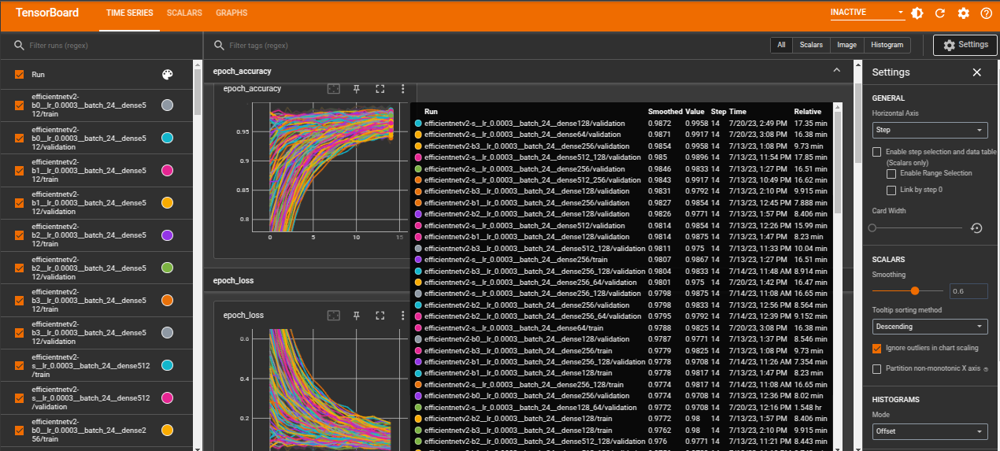

In [3]:
Image("/content/Screenshot from 2025-02-11 09-14-00.png")

# Model Training


In [ ]:
base_model = EfficientNetV2S(
    include_top=False, weights="imagenet", input_shape=(384, 384, 3), pooling="avg"
)
model = get_model(base_model, dense_units=[128], dropout=0.2)

model.compile(
    loss="categorical_crossentropy",
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0003),
    metrics=["accuracy", tf.keras.metrics.Recall(), tf.keras.metrics.Precision()],
)
model.summary()

82420632/82420632 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resizing (Resizing)         (None, 384, 384, 3)       0         
                                                                 
 efficientnetv2-s (Functiona  (None, 1280)             20331360  
 l)                                                              
                                                                 
 dense (Dense)               (None, 128)               163968    
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 5)                 645       
                                                                 
Total params: 20,495,973
Trainable params: 20,342,101
Non

In [ ]:
# hyperparam configs
batch_size = 24
n_epochs = 100
init_lr = 0.0003

# path assignment
log_name = f"{base_model.name}__lr_{str(init_lr)}__batch_{batch_size}__dense_128"
tb_logdir = (
    f"/content/drive/MyDrive/WheatDiseaseDetection/Training/TensorboardLogs/{log_name}"
)
ckptdir = f"/content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/{log_name}"
df_logdir = f"/content/drive/MyDrive/WheatDiseaseDetection/Training/DataframeLogs/{log_name}.csv"

# callbacks
tensorboard = TensorBoard(log_dir=tb_logdir, histogram_freq=1)
reduce_lr = ReduceLROnPlateau(
    monitor="val_accuracy", factor=0.97, patience=2, verbose=1, min_delta=0.0001
)
checkpoint = ModelCheckpoint(
    ckptdir, monitor="val_accuracy", verbose=1, save_best_only=True, save_freq="epoch"
)
earlystop = EarlyStopping(monitor="val_accuracy", patience=12, min_delta=0.0001)

# train model
print("\n", f"Started Training for {log_name}")
hist = model.fit(
    train_generator,
    epochs=n_epochs,
    validation_data=val_generator,
    # validation_steps=20,
    # steps_per_epoch =50,
    callbacks=[tensorboard, reduce_lr, checkpoint],
    # callbacks = [tensorboard, reduce_lr, earlystop, checkpoint]
)

# log to dataframe
keys = [*hist.history.keys()]
vals = [*hist.history.values()]
log_dict = {k: v for (k, v) in zip(keys, vals)}

df = pd.DataFrame.from_dict(data=log_dict, orient="columns")
df.to_csv(df_logdir, mode="a", header=True, index=False)


 Started Training for efficientnetv2-s__lr_0.0003__batch_24__dense_128
Epoch 1/100
511/511 [==============================] - ETA: 0s - loss: 0.2809 - accuracy: 0.9017 - recall: 0.8754 - precision: 0.9324
Epoch 1: val_accuracy improved from -inf to 0.97197, saving model to /content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/efficientnetv2-s__lr_0.0003__batch_24__dense_128


511/511 [==============================] - 3441s 6s/step - loss: 0.2809 - accuracy: 0.9017 - recall: 0.8754 - precision: 0.9324 - val_loss: 0.0831 - val_accuracy: 0.9720 - val_recall: 0.9716 - val_precision: 0.9742 - lr: 3.0000e-04
Epoch 2/100
511/511 [==============================] - ETA: 0s - loss: 0.0950 - accuracy: 0.9678 - recall: 0.9655 - precision: 0.9699
Epoch 2: val_accuracy did not improve from 0.97197
511/511 [==============================] - 657s 1s/step - loss: 0.0950 - accuracy: 0.9678 - recall: 0.9655 - precision: 0.9699 - val_loss: 0.0940 - val_accuracy: 0.9700 - val_recall: 0.9684 - val_precision: 0.9709 - lr: 3.0000e-04
Epoch 3/100
511/511 [==============================] - ETA: 0s - loss: 0.0718 - accuracy: 0.9750 - recall: 0.9737 - precision: 0.9772
Epoch 3: val_accuracy improved from 0.97197 to 0.98044, saving model to /content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/efficientnetv2-s__lr_0.0003__batch_24__dense_128


511/511 [==============================] - 765s 1s/step - loss: 0.0718 - accuracy: 0.9750 - recall: 0.9737 - precision: 0.9772 - val_loss: 0.0611 - val_accuracy: 0.9804 - val_recall: 0.9795 - val_precision: 0.9823 - lr: 3.0000e-04
Epoch 4/100
511/511 [==============================] - ETA: 0s - loss: 0.0601 - accuracy: 0.9814 - recall: 0.9801 - precision: 0.9824
Epoch 4: val_accuracy improved from 0.98044 to 0.98598, saving model to /content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/efficientnetv2-s__lr_0.0003__batch_24__dense_128


511/511 [==============================] - 761s 1s/step - loss: 0.0601 - accuracy: 0.9814 - recall: 0.9801 - precision: 0.9824 - val_loss: 0.0432 - val_accuracy: 0.9860 - val_recall: 0.9860 - val_precision: 0.9860 - lr: 3.0000e-04
Epoch 5/100
511/511 [==============================] - ETA: 0s - loss: 0.0590 - accuracy: 0.9803 - recall: 0.9792 - precision: 0.9814
Epoch 5: val_accuracy improved from 0.98598 to 0.99153, saving model to /content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/efficientnetv2-s__lr_0.0003__batch_24__dense_128


511/511 [==============================] - 763s 1s/step - loss: 0.0590 - accuracy: 0.9803 - recall: 0.9792 - precision: 0.9814 - val_loss: 0.0275 - val_accuracy: 0.9915 - val_recall: 0.9912 - val_precision: 0.9918 - lr: 3.0000e-04
Epoch 6/100
511/511 [==============================] - ETA: 0s - loss: 0.0373 - accuracy: 0.9875 - recall: 0.9866 - precision: 0.9880
Epoch 6: val_accuracy did not improve from 0.99153
511/511 [==============================] - 625s 1s/step - loss: 0.0373 - accuracy: 0.9875 - recall: 0.9866 - precision: 0.9880 - val_loss: 0.0639 - val_accuracy: 0.9808 - val_recall: 0.9804 - val_precision: 0.9820 - lr: 3.0000e-04
Epoch 7/100
511/511 [==============================] - ETA: 0s - loss: 0.0394 - accuracy: 0.9869 - recall: 0.9865 - precision: 0.9877
Epoch 7: val_accuracy improved from 0.99153 to 0.99316, saving model to /content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/efficientnetv2-s__lr_0.0003__batch_24__dense_128


511/511 [==============================] - 791s 2s/step - loss: 0.0394 - accuracy: 0.9869 - recall: 0.9865 - precision: 0.9877 - val_loss: 0.0219 - val_accuracy: 0.9932 - val_recall: 0.9922 - val_precision: 0.9931 - lr: 3.0000e-04
Epoch 8/100
511/511 [==============================] - ETA: 0s - loss: 0.0349 - accuracy: 0.9887 - recall: 0.9880 - precision: 0.9891
Epoch 8: val_accuracy did not improve from 0.99316
511/511 [==============================] - 625s 1s/step - loss: 0.0349 - accuracy: 0.9887 - recall: 0.9880 - precision: 0.9891 - val_loss: 0.0273 - val_accuracy: 0.9912 - val_recall: 0.9912 - val_precision: 0.9918 - lr: 3.0000e-04
Epoch 9/100
511/511 [==============================] - ETA: 0s - loss: 0.0382 - accuracy: 0.9878 - recall: 0.9871 - precision: 0.9882
Epoch 9: ReduceLROnPlateau reducing learning rate to 0.0002910000138217583.

Epoch 9: val_accuracy did not improve from 0.99316
511/511 [==============================] - 625s 1s/step - loss: 0.0382 - accuracy: 0.9878 -

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/WheatDiseaseDetection/Training/TensorboardLogs/

<IPython.core.display.Javascript object>

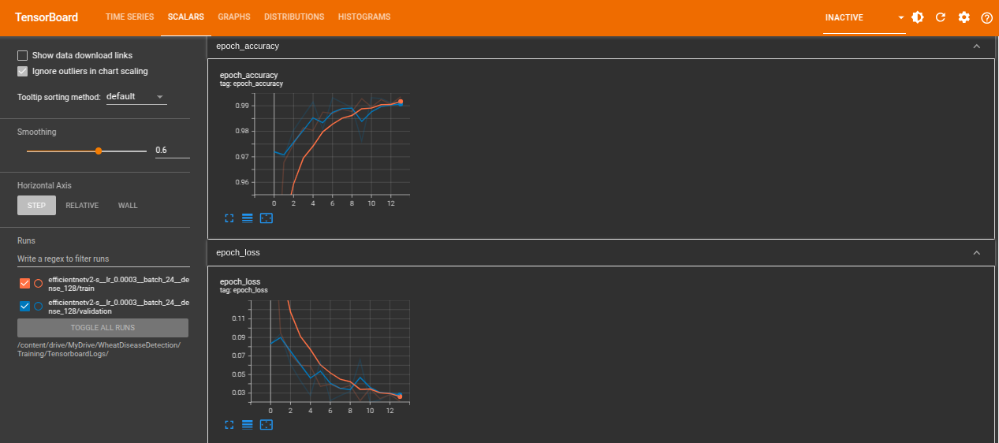

In [4]:
Image("/content/Screenshot from 2025-02-11 09-16-13.png")

In [ ]:
loss = hist.history["loss"]
val_loss = hist.history["val_loss"]
accuracy = hist.history["accuracy"]
val_accuracy = hist.history["val_accuracy"]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
ax1.plot(loss, label="Training Loss")
ax1.plot(val_loss, label="Validation Loss")
ax1.set_ylabel("Loss")
ax1.set_xlabel("Epochs")
ax1.legend(loc="upper right")
ax1.grid()

ax2.plot(accuracy, label="Training Accuracy")
ax2.plot(val_accuracy, label="Validation Accuracy")
ax2.set_ylabel("Accuracy")
ax2.set_xlabel("Epochs")
ax2.legend(loc="lower right")
ax2.grid()

plt.tight_layout()
plt.show()

# Model Evaluation


In [ ]:
model.load_weights(
    "/content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/efficientnetv2-s__lr_0.0003__batch_24__dense_128"
)
loss, acc, recall, precision = model.evaluate(test_generator, verbose=1)
print(f"     Test Loss: {loss:.5f}")
print(f"   Test recall: {recall:.5f}")
print(f"Test precision: {precision:.5f}")
print(f" Test Accuracy: {acc*100:.2f}%")

160/160 [==============================] - 867s 5s/step - loss: 0.0267 - accuracy: 0.9911 - recall: 0.9898 - precision: 0.9916
     Test Loss: 0.02666
   Test recall: 0.98983
Test precision: 0.99164
 Test Accuracy: 99.11%


In [ ]:
probs = model.predict(test_generator, verbose=1)
preds = np.argmax(probs, axis=-1)

print(accuracy_score(preds, test_generator.labels))
print(confusion_matrix(preds, test_generator.labels))
print(classification_report(preds, test_generator.labels))

160/160 [==============================] - 59s 354ms/step
0.9911342894393742
[[ 497    0    0    0    0]
 [   1  455   15    3    3]
 [   0    1  572    0    0]
 [   1    0    0 1406    6]
 [   2    0    2    0  871]]
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       497
           1       1.00      0.95      0.98       477
           2       0.97      1.00      0.98       573
           3       1.00      1.00      1.00      1413
           4       0.99      1.00      0.99       875

    accuracy                           0.99      3835
   macro avg       0.99      0.99      0.99      3835
weighted avg       0.99      0.99      0.99      3835



{'BrownRust': 0, 'Healthy': 1, 'Mildew': 2, 'Septoria': 3, 'YellowRust': 4}


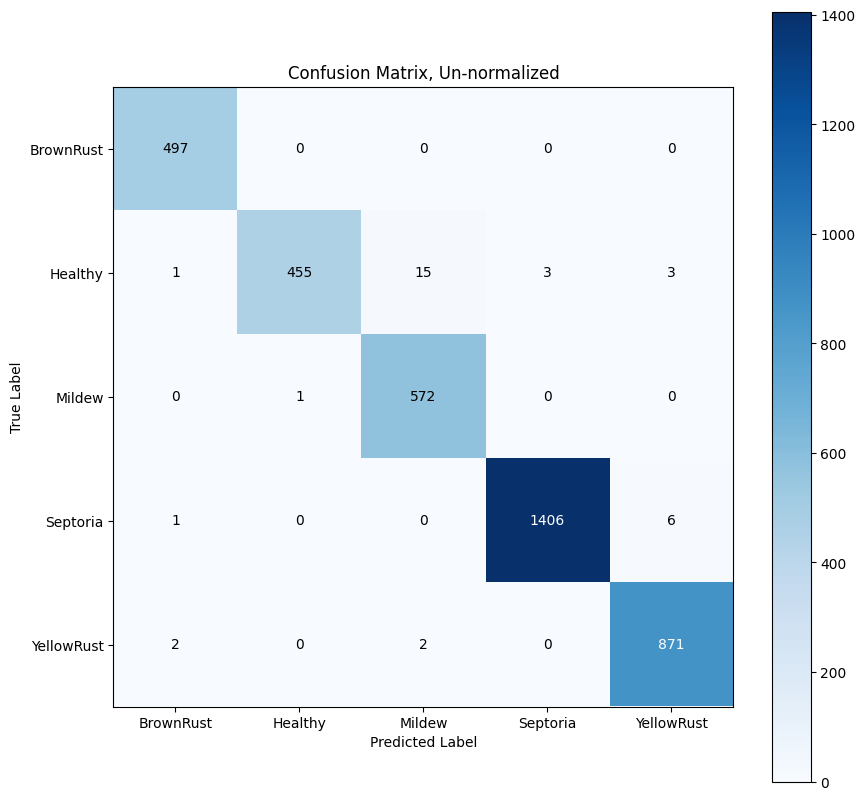

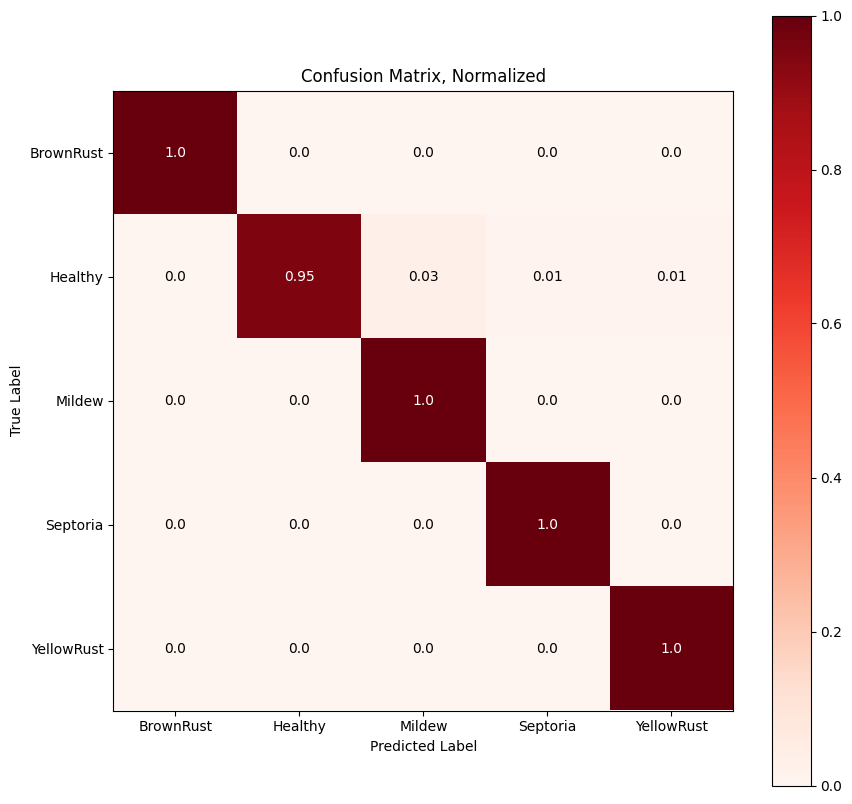

In [ ]:
print(test_generator.class_indices)
y_pred = [
    ["BrownRust", "Healthy", "Mildew", "Septoria", "YellowRust"][i] for i in preds
]
y_true = [
    ["BrownRust", "Healthy", "Mildew", "Septoria", "YellowRust"][i]
    for i in test_generator.labels
]

unnormalized = plot_confusion_matrix(
    y_pred, y_true, normalize=None, cmap="Blues", figsize=(10, 10)
)
unnormalized.set_ylabel("True Label")
unnormalized.set_xlabel("Predicted Label")
unnormalized.title.set_text("Confusion Matrix, Un-normalized")

normalized = plot_confusion_matrix(
    y_pred, y_true, normalize="all", cmap="Reds", figsize=(10, 10)
)
normalized.set_ylabel("True Label")
normalized.set_xlabel("Predicted Label")
normalized.title.set_text("Confusion Matrix, Normalized")
plt.show()

# [Model Explanation: Integrated Gradients](https://www.tensorflow.org/tutorials/interpretability/integrated_gradients)


In [ ]:
def get_model(base_model, dense_units, dropout=0.2):
    target_size = base_model.input_shape[1:]

    model = Sequential(
        [Input((400, 400, 3)), Resizing(target_size[0], target_size[1]), base_model]
    )

    for units in dense_units:
        model.add(Dense(units, activation="relu"))

        if dropout > 0:
            model.add(Dropout(dropout))
    model.add(Dense(5, activation="softmax"))
    return model

In [ ]:
# instantiate the model
base_model = EfficientNetV2S(
    include_top=False, weights="imagenet", input_shape=(384, 384, 3), pooling="avg"
)
model = get_model(base_model, dense_units=[128], dropout=0.2)

model.compile(
    loss="categorical_crossentropy",
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0003),
    metrics=["accuracy", tf.keras.metrics.Recall(), tf.keras.metrics.Precision()],
)
model.summary()

# load trained weights
model.load_weights(
    "/content/drive/MyDrive/WheatDiseaseDetection/Training/CkptDir/efficientnetv2-s__lr_0.0003__batch_24__dense_128"
)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resizing (Resizing)         (None, 384, 384, 3)       0         
                                                                 
 efficientnetv2-s (Functiona  (None, 1280)             20331360  
 l)                                                              
                                                                 
 dense (Dense)               (None, 128)               163968    
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 5)                 645       
                                                                 
Total params: 20,495,973
Trainable params: 20,342,101
Non-trainable params: 153,872
______________________________________

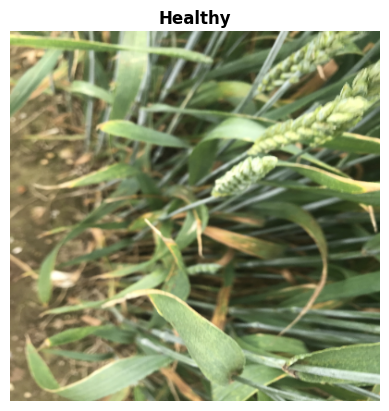

In [ ]:
# load random image
classes_ = ["BrownRust", "Healthy", "Mildew", "Septoria", "YellowRust"]
paths = glob("/content/drive/MyDrive/WheatDiseaseDetection/Dataset/Test/**/*.png")

rand_idx = randint(0, len(paths))
cls = paths[rand_idx].split("/")[-2]
img = cv2.cvtColor(cv2.imread(paths[rand_idx]), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.title(cls, fontweight="bold")
plt.axis("off")
plt.show()

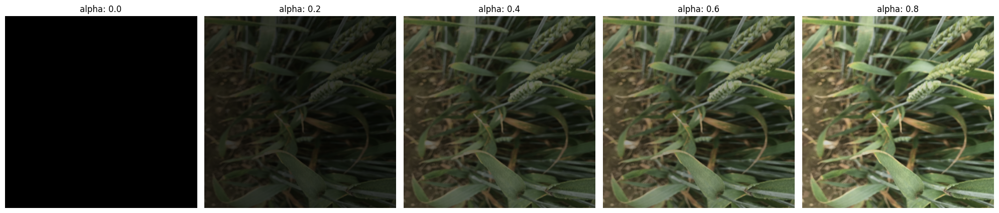

In [ ]:
baseline = tf.zeros(shape=(400, 400, 3))
m_steps = 24
alphas = tf.linspace(start=0.0, stop=1.0, num=m_steps + 1)  # generate m_steps intervals


def interpolate_images(baseline, image, alphas):
    alphas_x = alphas[:, tf.newaxis, tf.newaxis, tf.newaxis]
    baseline_x = tf.expand_dims(baseline, axis=0)
    input_x = tf.expand_dims(image, axis=0)
    delta = input_x - baseline_x
    images = baseline_x + alphas_x * delta
    return images


# generate interpolated images along a linear path at
# alpha intervals between a black baseline image and the input image
interpolated_images = interpolate_images(
    baseline=baseline, image=img.astype(np.float32), alphas=alphas
)


fig = plt.figure(figsize=(20, 20))
i = 0
for alpha, image in zip(alphas[0::5], interpolated_images.numpy()[0::5]):
    i += 1
    plt.subplot(1, len(alphas[0::5]), i)
    plt.title(f"alpha: {alpha:.1f}")
    plt.imshow(image.astype("uint8"))
    plt.axis("off")

plt.tight_layout()

In [ ]:
def interpolate_images(baseline, image, alphas):
    alphas_x = alphas[:, tf.newaxis, tf.newaxis, tf.newaxis]
    baseline_x = tf.expand_dims(baseline, axis=0)
    input_x = tf.expand_dims(image, axis=0)
    delta = input_x - baseline_x
    images = baseline_x + alphas_x * delta
    return images


def compute_gradients(images, target_class_idx):
    with tf.GradientTape() as tape:
        tape.watch(images)
        logits = model(images)
        probs = tf.nn.softmax(logits, axis=-1)[:, target_class_idx]
    return tape.gradient(probs, images)


@tf.function
def one_batch(baseline, image, alpha_batch, target_class_idx):
    # Generate interpolated inputs between baseline and input.
    interpolated_path_input_batch = interpolate_images(
        baseline=baseline, image=image, alphas=alpha_batch
    )

    # Compute gradients between model outputs and interpolated inputs.
    gradient_batch = compute_gradients(
        images=interpolated_path_input_batch, target_class_idx=target_class_idx
    )
    return gradient_batch


def integral_approximation(gradients):
    # riemann_trapezoidal
    grads = (gradients[:-1] + gradients[1:]) / tf.constant(2.0)
    integrated_gradients = tf.math.reduce_mean(grads, axis=0)
    return integrated_gradients


def integrated_gradients(baseline, image, target_class_idx, m_steps=50, batch_size=32):
    # Generate alphas.
    alphas = tf.linspace(start=0.0, stop=1.0, num=m_steps + 1)

    # Collect gradients.
    gradient_batches = []

    # Iterate alphas range and batch computation for speed, memory efficiency, and scaling to larger m_steps.
    for alpha in tf.range(0, len(alphas), batch_size):
        from_ = alpha
        to = tf.minimum(from_ + batch_size, len(alphas))
        alpha_batch = alphas[from_:to]

        gradient_batch = one_batch(baseline, image, alpha_batch, target_class_idx)
        gradient_batches.append(gradient_batch)

    # Concatenate path gradients together row-wise into single tensor.
    total_gradients = tf.concat(gradient_batches, axis=0)

    # Integral approximation through averaging gradients.
    avg_gradients = integral_approximation(gradients=total_gradients)

    # Scale integrated gradients with respect to input.
    integrated_gradients = (image - baseline) * avg_gradients

    return integrated_gradients


def plot_img_attributions(
    baseline, image, target_class_idx, m_steps=50, cmap=None, overlay_alpha=0.4
):

    attributions = integrated_gradients(
        baseline=baseline,
        image=image.astype("float32"),
        target_class_idx=target_class_idx,
        m_steps=m_steps,
    )

    # Sum of the attributions across color channels for visualization.
    # The attribution mask shape is a grayscale image with height and width
    # equal to the original image.
    attribution_mask = tf.reduce_sum(tf.math.abs(attributions), axis=-1)

    plt.figure(figsize=(18, 18))
    plt.subplot(1, 3, 1)
    plt.title("Original image", fontweight="bold")
    plt.imshow(image)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.title("Attribution mask", fontweight="bold")
    plt.imshow(attribution_mask, cmap=cmap)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.title("Overlay", fontweight="bold")
    plt.imshow(attribution_mask, cmap=cmap)
    plt.imshow(image, alpha=overlay_alpha)
    plt.axis("off")

    plt.tight_layout()

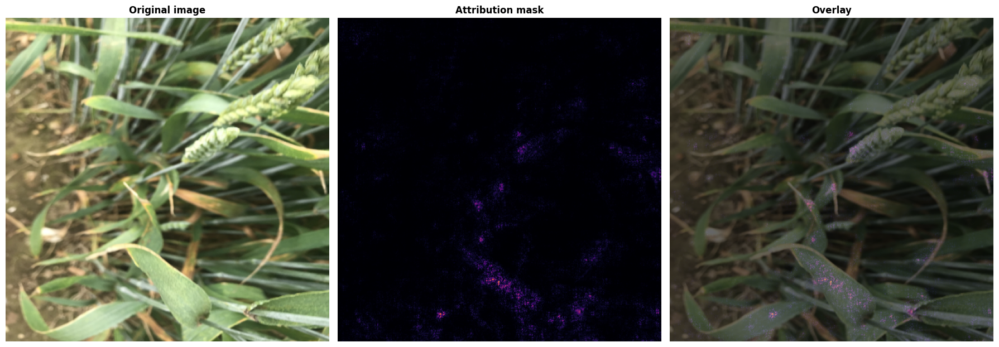

In [ ]:
baseline = tf.zeros(shape=(400, 400, 3))
m_steps = 240
plot_img_attributions(
    image=img,
    baseline=baseline,
    target_class_idx=1,
    m_steps=m_steps,
    cmap=plt.cm.inferno,
    overlay_alpha=0.4,
)

<Figure size 2000x2000 with 0 Axes>

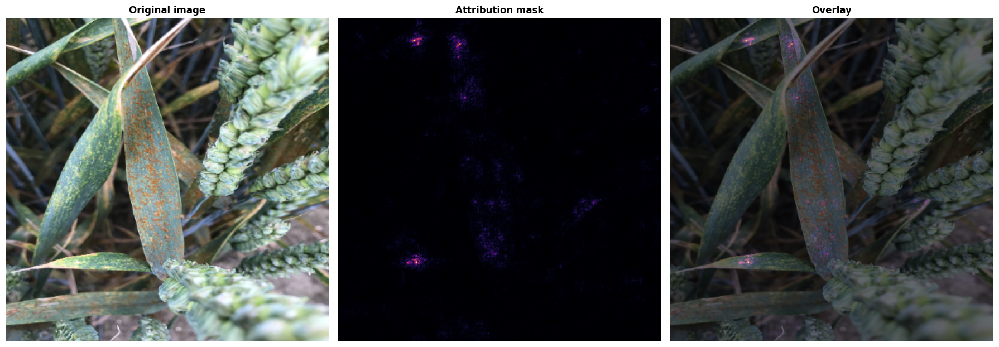

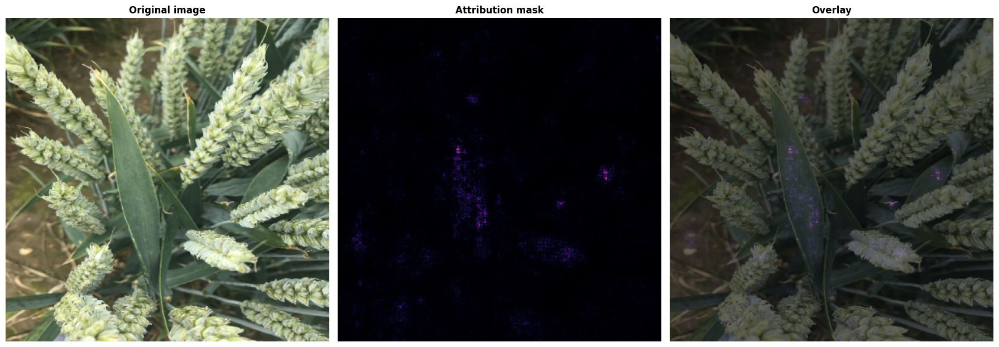

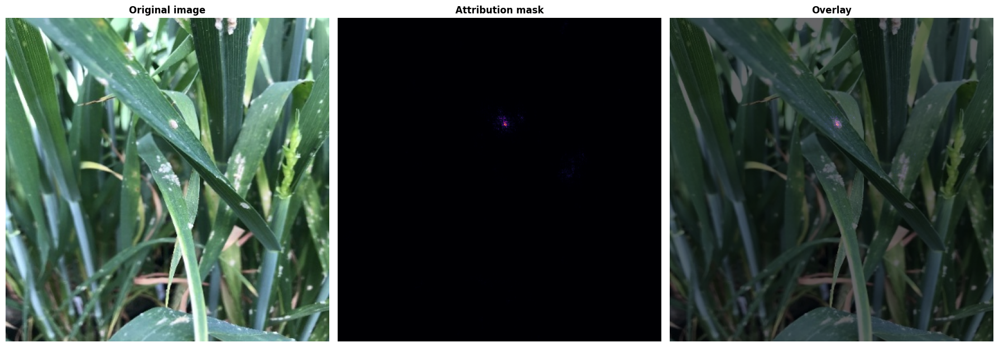

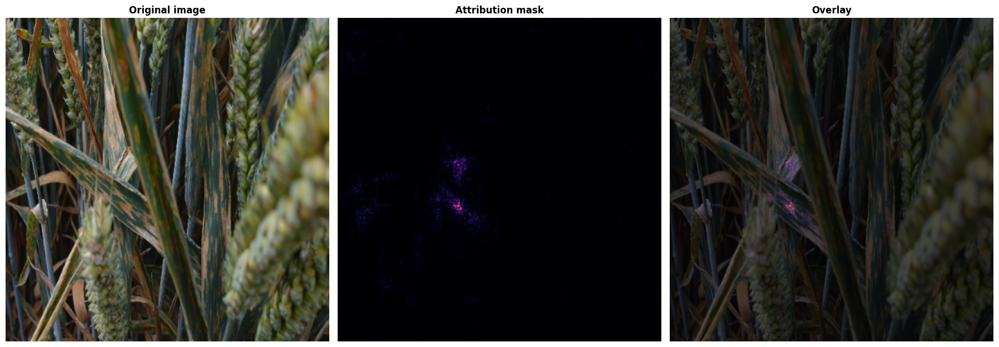

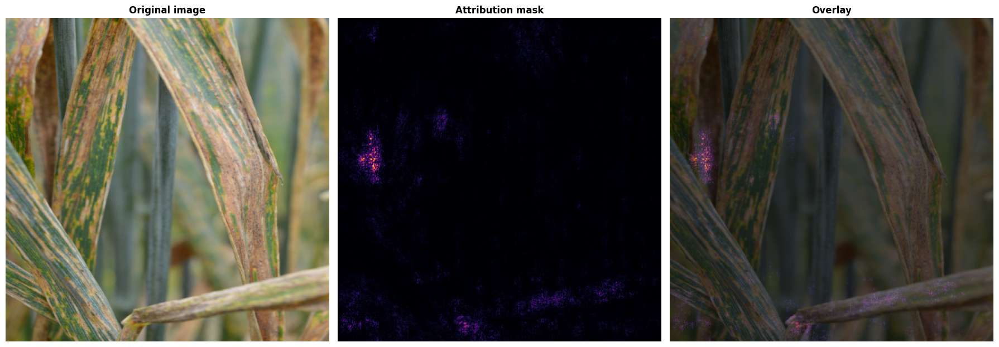

In [ ]:
# visualize images from each class
fig = plt.figure(figsize=(20, 20))
classes_ = ["BrownRust", "Healthy", "Mildew", "Septoria", "YellowRust"]
baseline = tf.zeros(shape=(400, 400, 3))
m_steps = 50

i = 0
for idx, cls in enumerate(classes_):
    i += 1
    paths = glob(f"/content/drive/MyDrive/WheatDiseaseDetection/Dataset/Train/{cls}/*")
    rand_idx = randint(0, len(paths))
    img = cv2.cvtColor(cv2.imread(paths[rand_idx]), cv2.COLOR_BGR2RGB)
    plot_img_attributions(
        image=img,
        baseline=baseline,
        target_class_idx=idx,
        m_steps=m_steps,
        cmap=plt.cm.inferno,
        overlay_alpha=0.4,
    )
plt.show()